
# Summary of water quality datasets
This file shows summary of all'multi-station' water quality datasets available in the package
and how to access these datasets.

At the time of running this script, the datasets have been previosly downloaded. Therefore,
if you run this script for the first time, it may take days to run or may even not
run successfully till the end due to internet connection issues. 


In [1]:
import os
import site

wd_dir = os.path.dirname(os.path.dirname(os.path.dirname(os.path.dirname(os.path.realpath('__file__')))))
#wd_dir = os.path.dirname(os.path.dirname(os.path.realpath('__file__')))
#wd_dir = os.path.dirname(os.path.realpath('__file__'))
print(wd_dir)
site.addsitedir(wd_dir)

import matplotlib
nice_fonts = {
    #"text.usetex": True,
    "font.family": "sans-serif",  #sans -serif
    #"font.serif" : "Times New Roman",
}
matplotlib.rcParams.update(nice_fonts)

from easy_mpl.utils import despine_axes

import matplotlib.pyplot as plt

from mpl_toolkits.basemap import Basemap

from aqua_fetch import (
    SWatCh, 
    GRQA, 
    Quadica, 
    GRiMeDB, 
    RC4USCoast, 
    CamelsChem,
    Camels_Ch_Chem,
    SyltRoads, 
    RiverChemSiberia,
    Oligotrend,
    ecoli_mekong
)

from aqua_fetch.utils import print_info

/home/abbaa0a/AquaFetch


In [2]:
print_info()

numpy 1.26.4
pandas 2.2.3
aqua_fetch 1.0.0rc3
python 3.12.4 | packaged by Anaconda, Inc. | (main, Jun 18 2024, 15:12:24) [GCC 11.2.0]
os posix
matplotlib 3.8.4
shapefile 2.3.1
xarray 2024.7.0
netCDF4 1.6.2
scipy 1.13.0
fiona 1.10.1
shapely 2.0.6
Script Executed on:  28 July 2025 16:18:35
tot_cpus 112
avail_cpus 112
mem_gib 251.52816772460938


In [3]:
coords_data = {}
for ds in [Quadica, 
           RC4USCoast, 
           CamelsChem,
           Camels_Ch_Chem,
           SyltRoads, ecoli_mekong, RiverChemSiberia,
           ]:

    if ds == ecoli_mekong:
        df = ecoli_mekong(parameters=['lat', 'long', 'station_name']).set_index('station_name')
        # drop rows with duplicate index
        df = df[~df.index.duplicated(keep='first')]
        coords_data['ecoli_mekong'] = df[['lat', 'long']]
    else:
        ds = ds()
        coords = ds.stn_coords()
        coords_data[ds.name] = coords


        Not downloading the data since the directory 
        /home/abbaa0a/AquaFetch/aqua_fetch/data/Quadica already exists.
        Use overwrite=True to remove previously saved files and download again

        Not downloading the data since the directory 
        /home/abbaa0a/AquaFetch/aqua_fetch/data/RC4USCoast already exists.
        Use overwrite=True to remove previously saved files and download again
Camels_chem_1980_2018.csv already exists in /home/abbaa0a/AquaFetch/aqua_fetch/data/CamelsChem
Gauge_and_region_names.csv already exists in /home/abbaa0a/AquaFetch/aqua_fetch/data/CamelsChem
Camel_Chem_Metrics.xlsx already exists in /home/abbaa0a/AquaFetch/aqua_fetch/data/CamelsChem
DepCon_671_1985_2018.xlsx already exists in /home/abbaa0a/AquaFetch/aqua_fetch/data/CamelsChem
DepCon_metadata.xlsx already exists in /home/abbaa0a/AquaFetch/aqua_fetch/data/CamelsChem
Camels_topography.csv already exists in /home/abbaa0a/AquaFetch/aqua_fetch/data/CamelsChem



        Not downloading the data since the directory 
        /home/abbaa0a/AquaFetch/aqua_fetch/data/Camels_Ch_Chem already exists.
        Use overwrite=True to remove previously saved files and download again

        Not downloading the data since the directory 
        /home/abbaa0a/AquaFetch/aqua_fetch/data/SyltRoads already exists.
        Use overwrite=True to remove previously saved files and download again
Reading data from pre-existing /home/abbaa0a/AquaFetch/aqua_fetch/data/SyltRoads/1973_2013.csv

        Not downloading the data since the directory 
        /home/abbaa0a/AquaFetch/aqua_fetch/data/RiverChemSiberia already exists.
        Use overwrite=True to remove previously saved files and download again


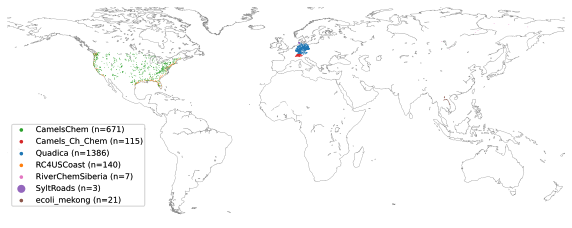

In [4]:
colors = plt.cm.tab10.colors

block1 = ['Quadica',
          'RC4USCoast', 
          'CamelsChem',
          'SyltRoads', 'ecoli_mekong', 'RiverChemSiberia', 'Camels_Ch_Chem']

# draw the figure
_, ax = plt.subplots(figsize=(10, 12))

map = Basemap(ax=ax, resolution='l',
              **{'llcrnrlat': -60, 'urcrnrlat': 78.0, 'llcrnrlon': -180.0, 'urcrnrlon': 180.0})
map.drawcoastlines(linewidth=0.3, ax=ax, color="gray", zorder=0)
#map.drawrivers(linewidth=0.1, ax=ax, color="blue", zorder=0)

rets = {}
items = {}
for idx, (ds_name, coords) in enumerate(coords_data.items()):

    if ds_name == 'SyltRoads':
        s = 10
    else:
        s = 2

    ret = map.scatter(coords['long'].values, coords['lat'].values,
                marker=".",
                s=s,
                linewidths=0.0,
                color = colors[idx],
                alpha=1.0,
                label=f"{ds_name} (n={coords.shape[0]})")
    
    rets[ds_name] = ret
    items[ds_name] = coords.shape[0]

leg1 = ax.legend(
    [rets[src] for src in sorted(block1)],
    [f"{src} (n={items[src]})" for src in sorted(block1)],
    markerscale=5,
    fontsize=8,
    borderpad=0.2,
    labelspacing=0.5,
    title_fontproperties={'weight': 'bold', 'size': 8+2},
    bbox_to_anchor=(0.001, 0.05),
    loc="lower left",
    framealpha=0.6
    )

ax.add_artist(leg1)

despine_axes(ax)
# plt.savefig("wq_summary.png", dpi=600, bbox_inches="tight")
plt.show()

In [5]:
ds = GRQA()
coords = ds.stn_coords()

_, ax = plt.subplots(figsize=(10, 12))

map = Basemap(ax=ax, resolution='l',
              **{'llcrnrlat': -60, 'urcrnrlat': 78.0, 'llcrnrlon': -180.0, 'urcrnrlon': 180.0})
map.drawcoastlines(linewidth=0.3, ax=ax, color="gray", zorder=0)

ret = map.scatter(coords['long'].values, coords['lat'].values,
            marker=".",
            s=1,
            linewidths=0.0,
            color = colors[idx],
            alpha=1.0,
            label=f"{ds_name} (n={coords.shape[0]})")
despine_axes(ax)
plt.show()


        Not downloading the data since the directory 
        /home/abbaa0a/AquaFetch/aqua_fetch/data/GRQA already exists.
        Use overwrite=True to remove previously saved files and download again
loading from pre-existing/home/abbaa0a/AquaFetch/aqua_fetch/data/GRQA/sites.csv



        Not downloading the data since the directory 
        /home/abbaa0a/AquaFetch/aqua_fetch/data/GRiMeDB already exists.
        Use overwrite=True to remove previously saved files and download again


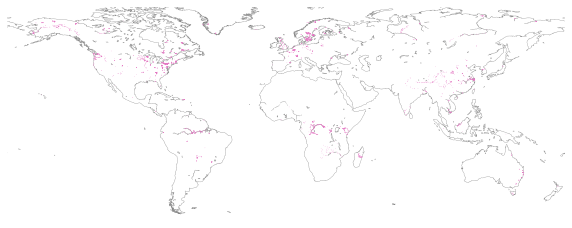

In [6]:
ds = GRiMeDB()
coords = ds.stn_coords()

_, ax = plt.subplots(figsize=(10, 12))

map = Basemap(ax=ax, resolution='l',
              **{'llcrnrlat': -60, 'urcrnrlat': 78.0, 'llcrnrlon': -180.0, 'urcrnrlon': 180.0})
map.drawcoastlines(linewidth=0.3, ax=ax, color="gray", zorder=0)

ret = map.scatter(coords['long'].values, coords['lat'].values,
            marker=".",
            s=1,
            linewidths=0.0,
            color = colors[idx],
            alpha=1.0,
            label=f"{ds_name} (n={coords.shape[0]})")
despine_axes(ax)
plt.show()

In [7]:
ds = SWatCh()
coords = ds.stn_coords()

_, ax = plt.subplots(figsize=(10, 12))

map = Basemap(ax=ax, resolution='l',
              **{'llcrnrlat': -60, 'urcrnrlat': 78.0, 'llcrnrlon': -180.0, 'urcrnrlon': 180.0})
map.drawcoastlines(linewidth=0.3, ax=ax, color="gray", zorder=0)

ret = map.scatter(coords['long'].values, coords['lat'].values,
            marker=".",
            s=1,
            linewidths=0.0,
            color = colors[idx],
            alpha=1.0,
            label=f"{ds_name} (n={coords.shape[0]})")
despine_axes(ax)
plt.show()


        Not downloading the data since the directory 
        /home/abbaa0a/AquaFetch/aqua_fetch/data/SWatCh already exists.
        Use overwrite=True to remove previously saved files and download again



        Not downloading the data since the directory 
        /home/abbaa0a/AquaFetch/aqua_fetch/data/Oligotrend already exists.
        Use overwrite=True to remove previously saved files and download again


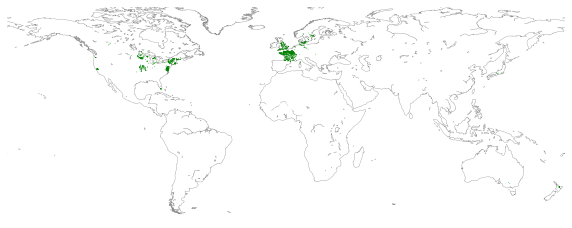

In [8]:
ds = Oligotrend()
coords = ds.stn_coords()

_, ax = plt.subplots(figsize=(10, 12))

map = Basemap(ax=ax, resolution='l',
              **{'llcrnrlat': -60, 'urcrnrlat': 78.0, 'llcrnrlon': -180.0, 'urcrnrlon': 180.0})
map.drawcoastlines(linewidth=0.3, ax=ax, color="gray", zorder=0)

ret = map.scatter(coords['long'].values, coords['lat'].values,
            marker=".",
            s=2,
            linewidths=0.0,
            c = 'green', 
            alpha=1.0,
            )
despine_axes(ax)
plt.show()